In [1]:
import os
import re
import sys
from pathlib import Path

import h5py
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import skimage
from skimage import io
from tqdm.notebook import tqdm, trange

sc.settings.verbosity = 3

import matplotlib
from matplotlib import cm, colors
from matplotlib.pyplot import rc_context

sc.set_figure_params(format="png")
import anndata as ad
import seaborn as sns
from PIL import Image
from scipy import ndimage
from skimage import exposure, measure, morphology
from sklearn.cluster import MiniBatchKMeans
import math
import cv2

In [2]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"

In [3]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

In [4]:
donors = [
    "LN Donor A",
    "LN Donor E",
    "INT Donor B",
    "INT Donor E",
    "TS Donor A",
    "TS Donor E",
]


# Read clustered data

In [5]:
adata_path = data_dir / "metadata" / f"combined_semi_final.h5ad"
adata = sc.read_h5ad(adata_path)

In [6]:
type_dict = {
             # 'GC B-cells': 'B cells', 
             # 'DZ B-cells': 'B cells', 
             # 'LZ B-cells': 'B cells',
             # 'Cytotoxic T-cells': 'T cells', 
             # 'Exhausted T-cells': 'T cells', 
             # 'Follicular CD8+ T-cells': 'T cells', 
             # 'Helper T-cells': 'T cells', 
             # 'Follicular Helper T-cells': 'T cells', 
             # 'Regulatory T-cells': 'T cells',
}

In [7]:
adata.obs['New'] = (
    adata.obs["Phenotype"]
    .map(lambda x: type_dict.get(x, x))
    .astype("category")
)
adata.uns["New_colors"] = sc.pl.palettes.vega_20_scanpy[:len(np.unique(adata.obs['New']))]


In [8]:
adata_subset = adata

# Read COL images

In [9]:
import matplotlib.patches as mpatches
from skimage.segmentation import mark_boundaries


def get_imgs(file_path, name):
    f = h5py.File(file_path, "r")
    imgs = f[name]
    labels = list(f[name].attrs["labels"])
    return imgs, labels


def contrast_streching(img):
    p2, p98 = np.percentile(img, (1, 99))
    return exposure.rescale_intensity(img, in_range=(p2, p98), out_range=(0, 255))

def get_img_size(roi_dict, size=1000):
    row_max = 0
    col_max = 0
    for k, v in roi_dict.items():
        row_max = max(row_max, v[0])
        col_max = max(col_max, v[1])
    return row_max + size, col_max + size

def get_img_subset(imgs, markers, labels):
    imgs_subset = []
    for marker in markers:
        idx = labels.index(marker)
        imgs_subset.append(imgs[idx])
    return np.stack(imgs_subset, axis=2)

In [10]:
# Format row, col
arrangement = {
    "LN Donor A": {
        1: [0, 1000],
        2: [0, 2000],
        3: [1000, 0],
        4: [1000, 1000],
        5: [1000, 2000],
        6: [1000, 3000],
        7: [2000, 0],
        8: [2000, 1000],
        9: [2000, 2000],
        10: [2000, 3000],
        11: [3000, 0],
        12: [3000, 1000],
        13: [3000, 2000],
        14: [3000, 3000],
        15: [4000, 1000],
        16: [4000, 2000],
    },
    "LN Donor E": {
        1: [1000, 0],
        2: [1000, 1000],
        3: [1000, 2000],
        4: [1000, 3000],
        5: [1000, 4000],
        6: [1000, 5000],
        7: [1000, 6000],
        8: [1000, 7000],
        9: [1000, 8000],
        10: [0, 0],
        11: [0, 1000],
        12: [0, 2000],
        13: [0, 3000],
        14: [0, 4000],
    },
    "INT Donor B": {
        1: [0, 0],
        2: [0, 1000],
        3: [1000, 0],
        4: [1000, 1000],
        5: [2000, 0],
        6: [2000, 1000],
        7: [2000, 2000],
        8: [2000, 3000],
        9: [3000, 0],
        10: [3000, 1000],
        11: [3000, 2000],
        12: [3000, 3000],
        13: [4000, 0],
        14: [4000, 1000],
        15: [4000, 2000],
        16: [4000, 3000],
        # 17: [5000, 0],
        # 18: [5000, 1000],
        # 19: [5000, 2000],
        # 20: [5000, 3000],
    },
    "INT Donor E": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [0, 3000],
        # 5: [0, 4000],
        6: [1000, 0],
        7: [1000, 1000],
        8: [1000, 2000],
        9: [1000, 3000],
        10: [1000, 4000],
        11: [2000, 3000],
        12: [2000, 4000],
        13: [3000, 3000],
        14: [3000, 4000],
        15: [4000, 3000],
        16: [4000, 4000],
    },
    "TS Donor A": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [0, 3000],
        5: [0, 4000],
        6: [0, 5000],
        7: [0, 6000],
        8: [1000, 0],
        9: [1000, 1000],
        10: [1000, 2000],
        11: [1000, 3000],
        12: [1000, 4000],
        13: [1000, 5000],
        14: [1000, 6000],
    },
    "TS Donor E": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [1000, 0],
        5: [1000, 1000],
        6: [1000, 2000],
        7: [2000, 0],
        8: [2000, 1000],
        9: [2000, 2000],
        10: [3000, 0],
        11: [3000, 1000],
        12: [3000, 2000],
        13: [4000, 0],
        14: [4000, 1000],
        15: [4000, 2000],
        16: [5000, 0],
        17: [5000, 1000],
        18: [5000, 2000],
    },
    "SP Donor A": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [0, 3000],
        5: [0, 4000],
        6: [1000, 0],
        7: [1000, 1000],
        8: [1000, 2000],
        9: [1000, 3000],
        10: [1000, 4000],
        11: [2000, 0],
        12: [2000, 1000],
        13: [2000, 2000],
        14: [2000, 3000],
        15: [2000, 4000],
        16: [3000, 0],
        17: [3000, 1000],
        18: [3000, 2000],
        19: [3000, 3000],
        20: [3000, 4000],
    },
}

In [11]:
# size = 1000 
# imgs_col = []

# # Read COL1 images
# for donor in donors:
#     h5_data = p_dir / "data" / "h5_new" / f"{donor}.hdf5"
    
#     # Create combined images
#     y_max, x_max = get_img_size(arrangement[donor])
#     img_col = np.zeros((y_max, x_max), dtype=np.uint8)

#     ROIs = [i for i in range(1, 21)]
#     for roi in tqdm(ROIs):
#         if roi not in arrangement[donor].keys():
#             continue

#         # Read imgs
#         imgs, labels = get_imgs(h5_data, str(roi))

#         # Get multiplex image
#         data = get_img_subset(imgs, ['COL1'], labels)

#         # Insert Combined images
#         y = arrangement[donor][roi][0]
#         x = arrangement[donor][roi][1]
#         img_col[y : y + size, x : x + size] = data[:1000,:1000].squeeze()

#     img_col= contrast_streching(img_col)
#     imgs_col.append(img_col)

In [12]:
marker = 'COL1'
imgs_col = []

# Read COL1 images
for donor in donors:
    path = p_dir / "data" / "whole_stitched"/ donor / f"{marker}.tif"
    
    img = skimage.io.imread(path)
    img_col= contrast_streching(img)
    if donor == 'INT Donor B':
        img_col = img_col[:5000, :]
    imgs_col.append(img_col)

# Plot COL with clustered cells

In [13]:
import matplotlib 
from PIL import Image

def create_clustered_cell(mask, label2cell, my_cmap, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1],3), dtype=np.uint8)

    # for i, cells in tqdm(label2cell.items(), total=len(label2cell), leave=False):
    for i, cells in label2cell.items():
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols, :] = my_cmap[int(i)]
    return img


def get_img_size(roi_dict, size=1000):
    row_max = 0
    col_max = 0
    for k, v in roi_dict.items():
        row_max = max(row_max, v[0])
        col_max = max(col_max, v[1])
    return row_max + size, col_max + size

# Read mask image
def get_masks(mask_folder):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition =  name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks


In [14]:
masks = {}
for d in donors:
    masks[d] = get_masks(data_dir / "masks" / d)

In [15]:
colors = adata_subset.uns["New_colors"]
labels = adata_subset.obs.New.cat.categories.tolist()

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

In [16]:
size = 1000 
imgs_BT = []

for d in donors:
    adata_donor = adata_subset[adata_subset.obs.Dataset == d, :]

    # Create combined images
    y_max, x_max = get_img_size(arrangement[d])
    img_combined = np.zeros((y_max, x_max, 3), dtype=np.uint8)

    for i in adata_donor.obs.ROI.unique():
        if i not in arrangement[d].keys():
            continue

        # Get dataset
        adata_s = adata_donor[adata_donor.obs.ROI == i, :]

        # Get mask
        mask = masks[d][str(int(i))]

        # Get label2cell dict
        label2cell = {}
        for j, l in enumerate(labels):
            cell_id = adata_s[adata_s.obs.New == l].obs.Cell.to_list()
            label2cell[j] = cell_id

        img = create_clustered_cell(mask, label2cell, colors_rgb)

        # Insert to combine image
        y = max(0, arrangement[d][i][0] - 1)
        x = max(0, arrangement[d][i][1] - 1)
        img_combined[y : y + size, x : x + size] = img

    imgs_BT.append(img_combined)

In [17]:
from matplotlib.colors import LinearSegmentedColormap

# get colormap
ncolors = 100
color_array = plt.get_cmap('Wistia')(range(ncolors))

# change alpha values
color_array[:,-1] = np.linspace(0.0,1.0, ncolors)

# create a colormap object
mycmap= LinearSegmentedColormap.from_list(name='mycmap', colors=color_array)


In [18]:
# for i in range(6):
#     img_col = imgs_col[i]
#     img_bt = imgs_BT[i]
    
#     fig, ax = plt.subplots(figsize=(20,20))
#     ax.imshow(img_bt, alpha=0.7)
#     ax.imshow(img_col, cmap=mycmap, alpha=0.9) 
#     ax.axis('off')

# Plot with follicle region

In [19]:
def get_contour(mask: np.ndarray):
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.1)[0])

    return contours

In [20]:
masks_follicle = get_masks(data_dir / 'masks_follicle')


In [21]:
# sns.set_style('white')

# for i in range(6):
#     # Get COL image, clustered cell image and follicle mask
#     img_col = imgs_col[i]
#     img_bt = imgs_BT[i]
#     mask = masks_follicle[donors[i]]
    
#     # Get follicle contours
#     contours = get_contour(mask)
   
#     # Plot images
#     fig, ax = plt.subplots(figsize=(20,20))
#     ax.imshow(img_bt, alpha=0.85)
#     ax.imshow(img_col, cmap=mycmap, alpha=0.9) 
#     for j, contour in enumerate(contours):
#         ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red", linestyle='dashed')
#     ax.axis("off")
#     save_path = p_dir / "figures" / "clustering" / f"COL_{i}.png"
#     fig.savefig(save_path, bbox_inches='tight',transparent=True, pad_inches=0)


# Analysis of follicle with COL markers

In [22]:
from skimage.measure import block_reduce, regionprops_table, regionprops
from joblib import Parallel, delayed
from functools import partial

def mean_block(img, size):
    reduced = block_reduce(img, block_size=(size, size), func=np.mean)
    img_mean = np.repeat(reduced, size, axis=0)
    img_mean = np.repeat(img_mean, size, axis=1)
    img_mean[:img.shape[0], :img.shape[1]]
    return reduced, img_mean 

def get_prop_foll(mask, prop):
    props = regionprops_table(mask, properties=prop)
    
    return pd.DataFrame(props) 

def read_morphology_prop(mask):
    props = skimage.measure.regionprops_table(
        mask,
        properties=[
            "label",
            "area",
            "eccentricity",
            "centroid",
            "bbox",
            "orientation",
            "major_axis_length",
            "minor_axis_length",
        ],
    )
    df_prop = pd.DataFrame(props)
    return df_prop

def sector_mask(angle_range, shape, centre, radius):
    """
    Return a boolean mask for a circular sector. The start/stop angles in  
    `angle_range` should be given in clockwise order.
    """

    x,y = np.ogrid[:shape[0],:shape[1]]
    cx,cy = centre
    # tmin,tmax = np.deg2rad(angle_range)
    tmin,tmax = angle_range
    
    # ensure stop angle > start angle
    if tmax < tmin:
        tmax += 2*np.pi

    # convert cartesian --> polar coordinates
    r2 = (x-cx)*(x-cx) + (y-cy)*(y-cy)
    theta = 2*np.pi - np.arctan2(x-cx,y-cy) - tmin

    # wrap angles between 0 and 2*pi
    theta %= (2*np.pi)

    # circular mask
    circmask = r2 <= radius*radius

    # angular mask
    anglemask = theta <= (tmax-tmin)

    return circmask*anglemask

def get_contour(mask: np.ndarray):
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        c = measure.find_contours(mask == i, 0.1, fully_connected='high')
        c = max(c, key = len)   
        contours.append(c)

    return contours

In [23]:
# # Get follicle props for downstream analysis
# masks_follicle = get_masks(data_dir / 'masks_follicle')

# # Prop
# size = 20
# thresh = 60
# N = 40
# radius = 1200
# theta = np.linspace(0.0, 2 * np.pi, N+1, endpoint=True)
# width = (2*np.pi) / N

# prop_list = ['label', 'area', 'centroid', 'bbox']
# columns_name = ['Label', 'Area', 'col', 'row', 'min_row', 'min_col', 'max_row', 'max_col']
# columns_name  = [
#     "Region_label",
#     "area",
#     "eccentricity",
#     'col', 'row',
#     "min_row",
#     "min_col",
#     "max_row",
#     "max_col",
#     "orientation",
#     "axis_major_length",
#     "axis_minor_length",
# ]

# for i in range(len(donors)):
    
#     # Read COL image and follicle mask
#     img_col = imgs_col[i]
#     mask = masks_follicle[donors[i]]
#     print(img_col.shape)
    
#     # Make mask shape matchig img shape
#     mask = mask[:img_col.shape[0], :img_col.shape[1]]
#     r = img_col.shape[0] - mask.shape[0]
#     c = img_col.shape[1] - mask.shape[1]
#     mask = cv2.copyMakeBorder(mask, 0, r, 0, c, cv2.BORDER_CONSTANT, None, value = 0)
    
#     # Get average marker image
#     reduced, img_mean = mean_block(img_col, size)
#     col_pos = reduced > thresh
#     img_mean_pos = img_mean > thresh

#     # Get follcile mask info
#     df = read_morphology_prop(mask)
#     df.columns = columns_name
    
#     # Get follicle to col analysis
#     radius_dict = {}
#     for row in tqdm(df.itertuples(), total=len(df)):
#         y0 = row.col
#         x0 = row.row
#         f_partial = partial(sector_mask, shape=img_mean.shape, centre=[y0,x0], radius=radius)
#         masks_rad = Parallel()(delayed(f_partial)([theta[j],theta[j+1]]) for j in range(N))
#         masks_rad = np.array(masks_rad)
#         # masks_rad_foll = np.where(mask==0, masks_rad, False)

#         radii = [np.sum(img_mean_pos[mask_rad]) for mask_rad in masks_rad]
#         rad = np.array(radii, dtype=float)
#         if rad.max() != 0:
#             rad /= rad.max()
#         radius_dict[row.Region_label] =  [rad]
    
#     df_rad = pd.DataFrame.from_dict(radius_dict, orient='index')
#     df_rad.columns = ['COL']
    
#     # Merge data
#     df = df.merge(df_rad, left_on='Region_label', right_index=True)
    
#     # Save data
#     path = data_path = data_dir / "follicle" / f"{donors[i]}.csv"
#     df.to_csv(path, index=False)

(5000, 4000)


  0%|          | 0/15 [00:00<?, ?it/s]

(2000, 9000)


  0%|          | 0/18 [00:00<?, ?it/s]

(5000, 4000)


  0%|          | 0/5 [00:00<?, ?it/s]

(5000, 5000)


  0%|          | 0/11 [00:00<?, ?it/s]

(2000, 7000)


  0%|          | 0/23 [00:00<?, ?it/s]

(6000, 3000)


  0%|          | 0/22 [00:00<?, ?it/s]

## Viz individual tissue

In [24]:
def create_circular_mask(img, center, radius):
    mask = np.zeros(img.shape, dtype=np.uint8)
    mask = cv2.circle(mask, center, radius, 255, -1)
    return mask

def circular_mean(weights, angles):
    x = y = 0.
    for angle, weight in zip(angles, weights):
        x += math.cos(angle) * weight
        y += math.sin(angle) * weight

    mean = math.atan2(y, x)
    return mean

In [25]:
from matplotlib.colors import LinearSegmentedColormap, ListedColormap

# get colormap
ncolors = 100
color_array = plt.get_cmap('Wistia')(range(ncolors))

# change alpha values
color_array[:,-1] = np.zeros(ncolors)
color_array[ncolors//2:, -1] = np.linspace(0.0,1.0, ncolors//2)

# create a colormap object
mycmap= LinearSegmentedColormap.from_list(name='mycmap', colors=color_array)


In [26]:
N = 30
theta = np.linspace(0.0, 2 * np.pi, N+1, endpoint=True)


In [27]:
radius = 1000
i = 5
size = 50

# Read COL image and follicle mask
img_col = imgs_col[i]
mask = masks_follicle[donors[i]]
print(img_col.shape)

# Make mask shape matchig img shape
mask = mask[:img_col.shape[0], :img_col.shape[1]]
r = img_col.shape[0] - mask.shape[0]
c = img_col.shape[1] - mask.shape[1]
mask = cv2.copyMakeBorder(mask, 0, r, 0, c, cv2.BORDER_CONSTANT, None, value = 0)

# Get average marker image
reduced, img_mean = mean_block(img_col, size)
col_pos = reduced > thresh
img_mean_pos = img_mean > thresh

# Get follcile mask info
df = read_morphology_prop(mask)
df.columns = columns_name

row = df.iloc[10]
y0 = row.col
x0 = row.row

f_partial = partial(sector_mask, shape=img_mean.shape, centre=[y0,x0], radius=radius)
masks_rad = Parallel()(delayed(f_partial)([theta[j],theta[j+1]]) for j in range(N))
masks_rad = np.array(masks_rad)
# masks_rad_foll = np.where(mask==0, masks_rad, False)

radii = [np.sum(img_mean_pos[mask_rad]) for mask_rad in masks_rad]
rad = np.array(radii, dtype=float)
if rad.max() != 0:
    rad /= rad.max()

mask_cir = create_circular_mask(img_mean_pos, (int(x0),int(y0)), radius)
mask_sector = sector_mask([theta[0], theta[10]], img_col.shape, (int(y0),int(x0)), radius)
img_col_mask = np.where(mask_cir>0, img_mean_pos, mask_cir)
img_col_mask2 = np.where(mask_sector>0, img_mean_pos, mask_sector)

(6000, 3000)


(-0.5, 2999.5, 5999.5, -0.5)

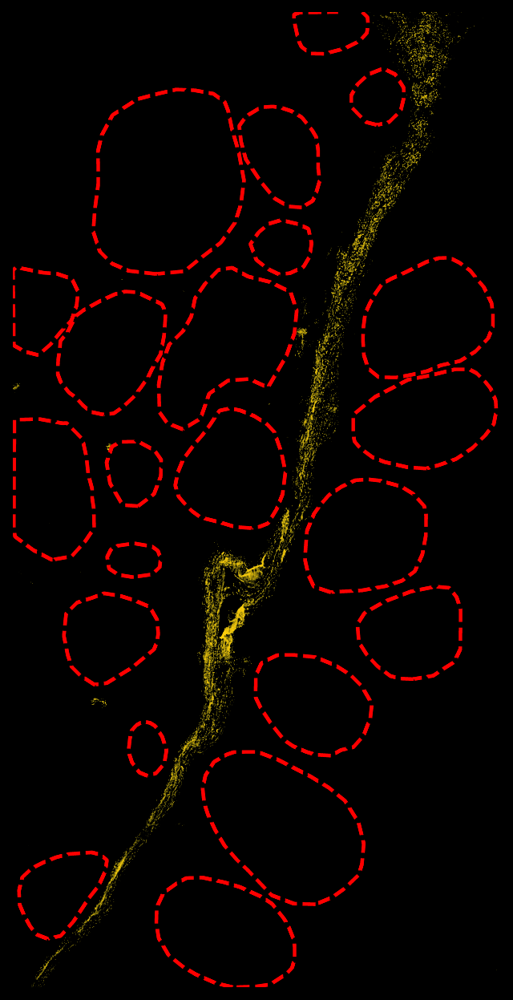

In [28]:
# Get follicle contours
contours = get_contour(mask)

# plot follicle with COL image
fig, ax = plt.subplots(figsize=(10,10), facecolor='k')
ax.imshow(img_col, cmap=mycmap, alpha=1) 
for j, contour in enumerate(contours):
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red", linestyle='dashed')
ax.axis("off")

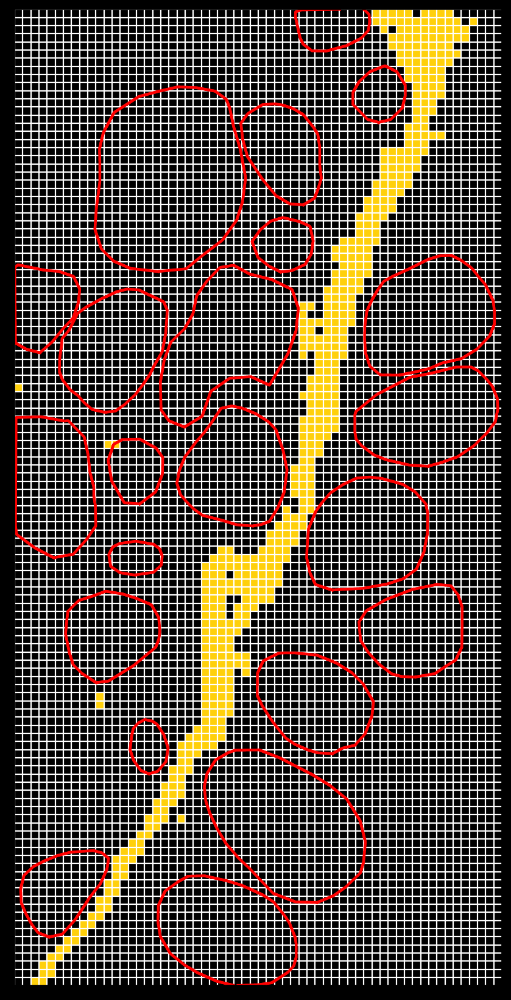

In [29]:
import matplotlib.ticker as plticker

# plot follicle with COL image
fig, ax = plt.subplots(figsize=(10,10), facecolor='k')
ax.imshow(img_mean_pos, cmap=mycmap, alpha=1) 
for j, contour in enumerate(contours):
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red")
loc = plticker.MultipleLocator(base=size)
ax.xaxis.set_major_locator(loc)
ax.yaxis.set_major_locator(loc)
ax.grid(which='major', axis='both', color='w', linewidth=1)
ax.set_facecolor('k')
ax.set_xticklabels([])
ax.set_yticklabels([])
fig.subplots_adjust(left=0,right=1,bottom=0,top=1)


In [30]:
f_partial = partial(sector_mask, shape=img_mean.shape, centre=[y0,x0], radius=radius)
masks_rad = Parallel()(delayed(f_partial)([theta[j],theta[j+1]]) for j in range(N))

contour = contours[10]
contour_cir = get_contour(mask_cir)[0]
contours_sec = [get_contour(m.astype(np.uint8))[0] for m in masks_rad]

(-0.5, 2999.5, 5999.5, -0.5)

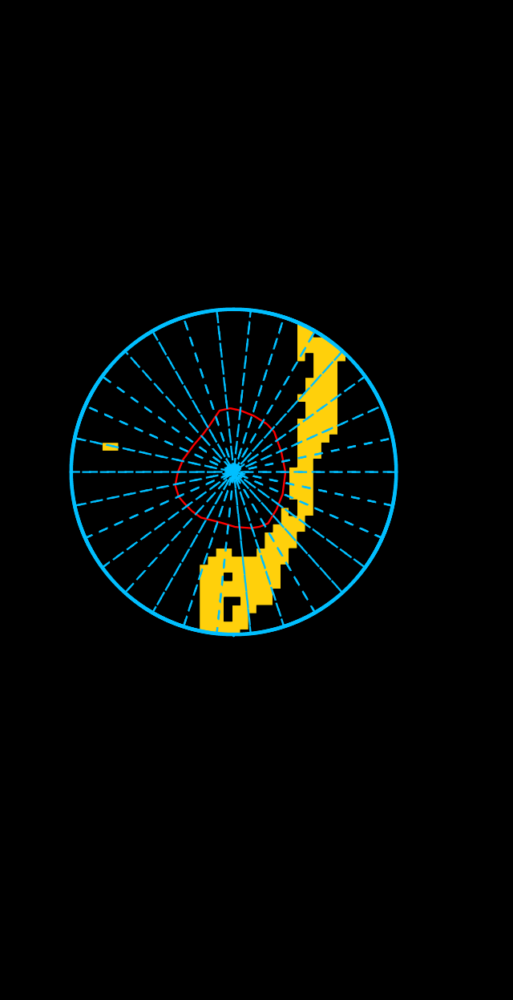

In [31]:
fig, ax = plt.subplots(figsize=(10,10), facecolor='k')
ax.imshow(img_col_mask, cmap=mycmap)
ax.plot(contour[:, 1], contour[:, 0], linewidth=1, color="red")
ax.plot(contour_cir[:, 1], contour_cir[:, 0], linewidth=2, color="deepskyblue")
for j, contour_sec in enumerate(contours_sec):
    ax.plot(contour_sec[:, 1], contour_sec[:, 0], linewidth=1, linestyle='--', dashes=(5, 5), color="deepskyblue")
ax.set_facecolor('k')
ax.axis('off')

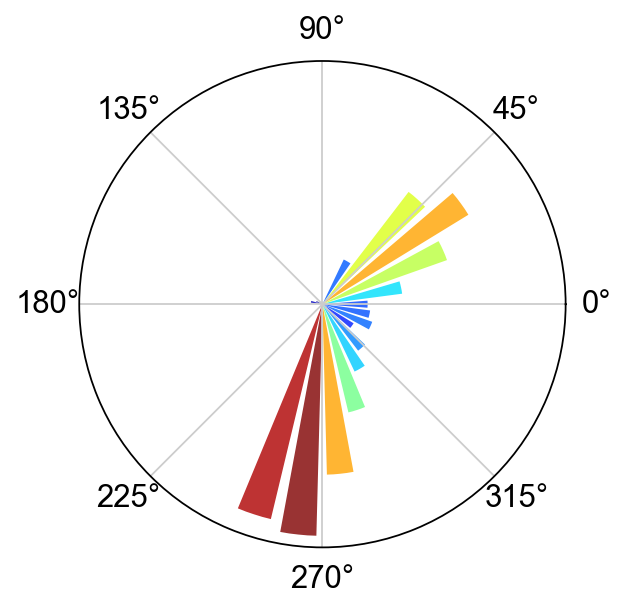

In [32]:
# Get weighted average of count along polar direction
mean = circular_mean(rad, theta[:-1])

# Plot count per angle and weighted average
cmap = cm.get_cmap('jet', 100)
ax = plt.subplot(111, polar=True)
ax.set_rticks([])
# ax.vlines(mean, ymin=0, ymax=1, colors='m', zorder=3, linewidth=5)
# ax.vlines(orientation, 0, 1, colors='darkgreen', zorder=3, linewidth=5)
bars = ax.bar(theta[:-1], rad, width=width) 
# Use custom colors and opacity
for r, bar in zip(rad, bars):
    bar.set_facecolor(cmap(r))
    bar.set_alpha(0.8)
plt.show()

(-0.5, 2999.5, 5999.5, -0.5)

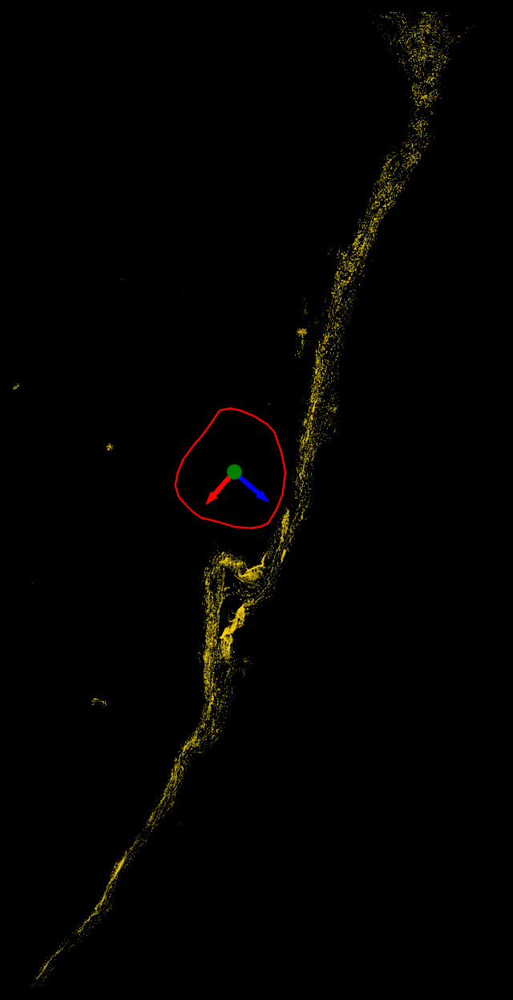

In [ ]:
y0 = row.col
x0 = row.row
orientation = mean
axis_major_length = row.axis_major_length
axis_minor_length = row.axis_minor_length

x1 = math.sin(orientation) * 0.3 * axis_minor_length
y1 = math.cos(orientation) * 0.3 * axis_minor_length 
x2 = math.cos(orientation) * 0.3 * axis_major_length
y2 = -math.sin(orientation) * 0.3 * axis_major_length

fig, ax = plt.subplots(figsize=(10,10), facecolor='k')
ax.imshow(img_col, cmap=mycmap)
ax.plot(contour[:, 1], contour[:, 0], linewidth=1, color="red")
ax.arrow(x0, y0, x1, y1, color='r', linewidth=2.5, head_width=20)
ax.arrow(x0, y0, x2, y2, color='b', linewidth=2.5, head_width=20)
ax.plot(x0, y0, '.g', markersize=15)
ax.axis('off')

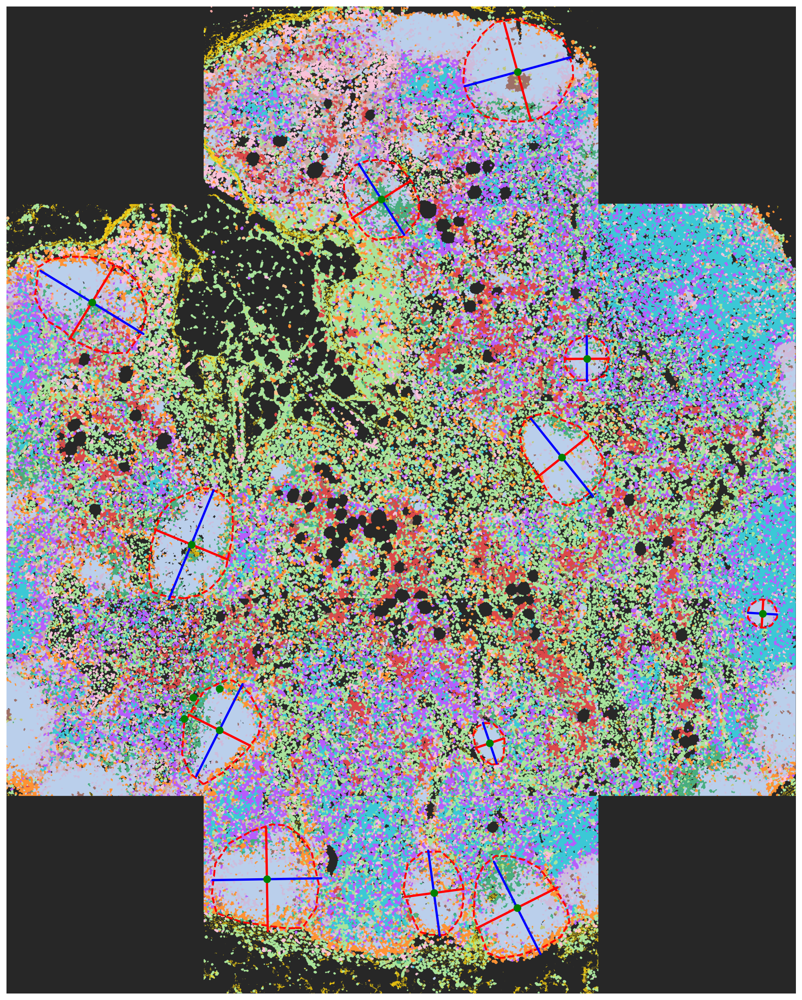

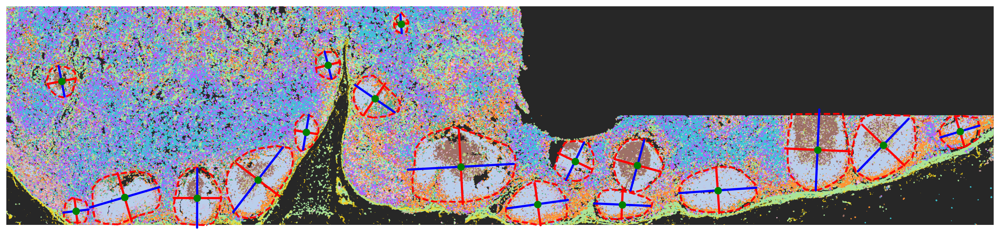

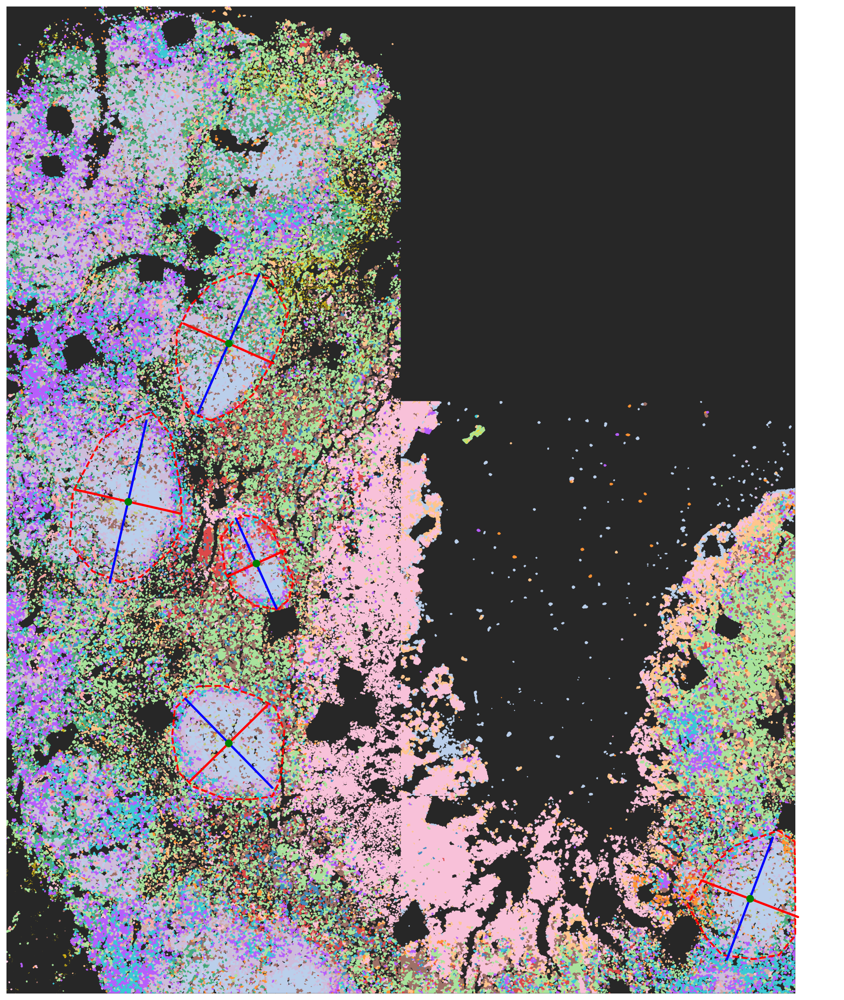

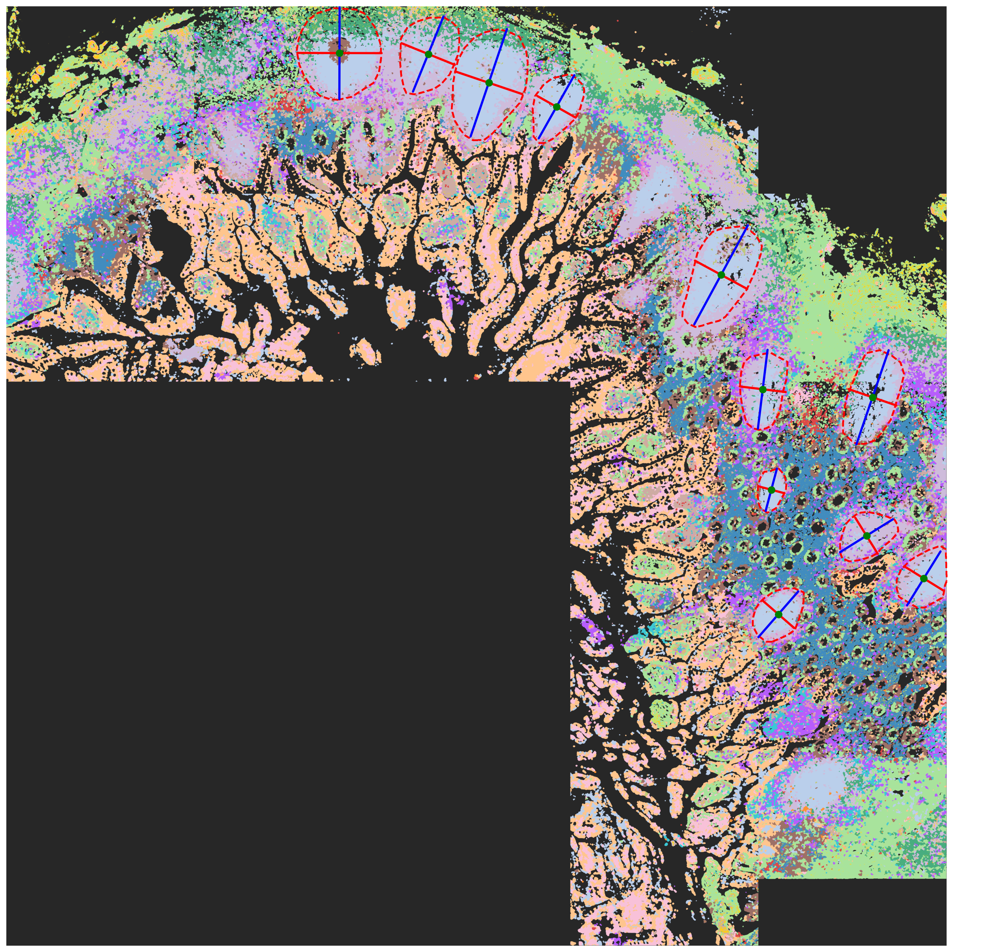

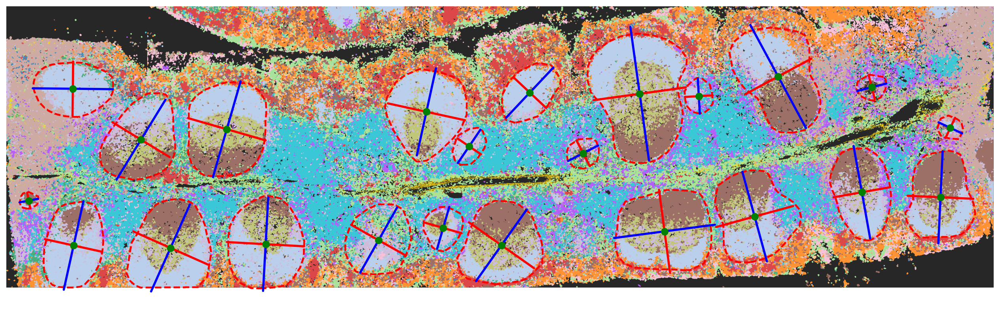

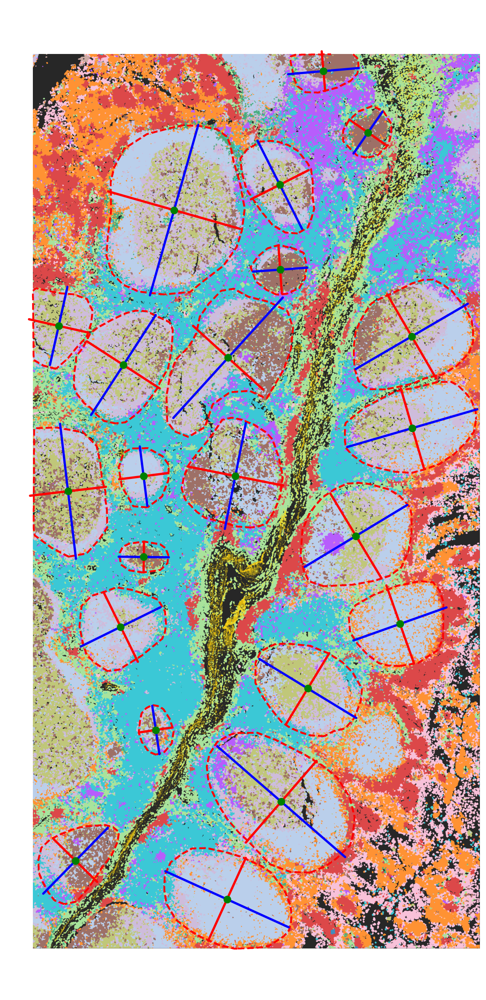

In [34]:
sns.set_style('white')

for i in range(6):
    # Get COL image, clustered cell image and follicle mask
    img_col = imgs_col[i]
    img_bt = imgs_BT[i]
    mask = masks_follicle[donors[i]]
    
    # Get follcile mask info
    df = read_morphology_prop(mask)
    df.columns = columns_name
   
    # Get follicle contours
    contours = get_contour(mask)
   
    # Plot images
    fig, ax = plt.subplots(figsize=(20,20))
    ax.imshow(img_bt, alpha=0.85)
    ax.imshow(img_col, cmap=mycmap, alpha=0.9) 
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red", linestyle='dashed')
    ax.axis("off")

    for row in df.itertuples():
        y0 = row.col
        x0 = row.row
        orientation = row.orientation
        axis_major_length = row.axis_major_length
        axis_minor_length = row.axis_minor_length
        minr = row.min_row
        minc = row.min_col
        maxr = row.max_row
        maxc = row.max_col

        x1 = x0 + math.cos(orientation) * 0.5 * axis_minor_length 
        y1 = y0 - math.sin(orientation) * 0.5 * axis_minor_length
        x1_bis = x0 + math.cos(np.pi + orientation) * 0.5 * axis_minor_length 
        y1_bis = y0 - math.sin(np.pi + orientation) * 0.5 * axis_minor_length

        x2 = x0 - math.sin(orientation) * 0.5 * axis_major_length
        y2 = y0 - math.cos(orientation) * 0.5 * axis_major_length
        x2_bis = x0 - math.sin(np.pi + orientation) * 0.5 * axis_major_length
        y2_bis = y0 - math.cos(np.pi + orientation) * 0.5 * axis_major_length

        ax.plot((x1_bis, x1), (y1_bis, y1), '-r', linewidth=2.5)
        ax.plot((x2_bis, x2), (y2_bis, y2), '-b', linewidth=2.5)
        ax.plot(x0, y0, '.g', markersize=15)

        bx = (minc, maxc, maxc, minc, minc)
        by = (minr, minr, maxr, maxr, minr)
    
    save_path = p_dir / "figures" / "clustering" / f"COL_follcile{i}.png"
    fig.savefig(save_path, bbox_inches='tight',transparent=True, pad_inches=0)
